### Soal 1. Analisis Suara Multi-Level

Original Sample Rate: 48000 Hz


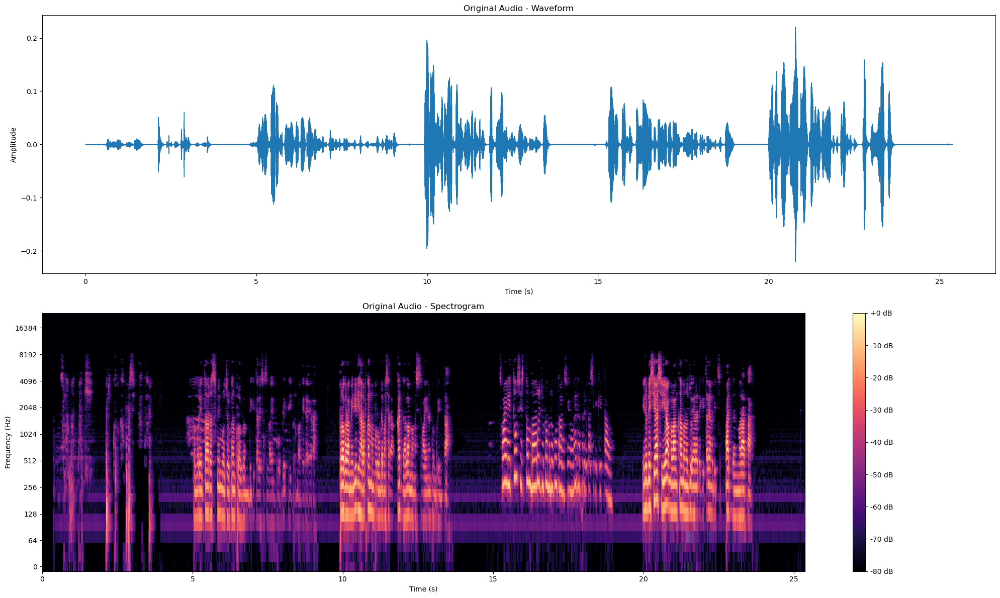

Resampled Sample Rate: 8000 Hz


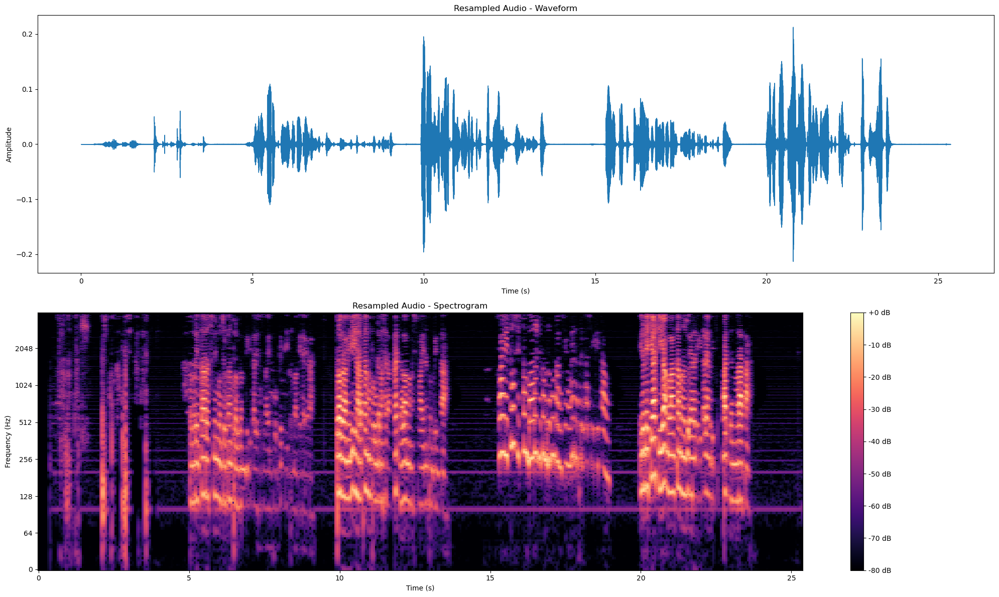

Duration of Original Audio: 25.37 seconds
Duration of Resampled Audio: 25.37 seconds
Audio Before Resampling


Audio After Resampling


In [35]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import soundfile as sf
import IPython.display as ipd
from IPython.display import display

# Fungsi Visualisasi Waveform and Spectrogram
def visualize_audio(y, sr, title="Audio Signal"):
    plt.figure(figsize=(20, 12))

    # Waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"{title} - Waveform")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

    # Spectrogram
    plt.subplot(2, 1, 2)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"{title} - Spectrogram")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    plt.tight_layout()
    plt.show()

# Load Audio File
audio_path = 'Data/rekaman_berita_multilevel.wav'
y, sr = librosa.load(audio_path, sr=None)

# Information about the audio
print(f"Original Sample Rate: {sr} Hz")

# Visualize Original Audio
visualize_audio(y, sr, title="Original Audio")

# Resample Audio to 8000 Hz
sr_resampled = 8000
y_resampled = librosa.resample(y, orig_sr=sr, target_sr=sr_resampled)
print(f"Resampled Sample Rate: {sr_resampled} Hz")

# Visualize Resampled Audio
visualize_audio(y_resampled, sr_resampled, title="Resampled Audio")

# Save Resampled Audio
resampled_audio_path = 'Data/rekaman_berita_multilevel_resampled.wav'
sf.write(resampled_audio_path, y_resampled, sr_resampled)

# Duration of the audio 
duration_original = librosa.get_duration(y=y, sr=sr)
duration_resampled = librosa.get_duration(y=y_resampled, sr=sr_resampled)
print(f"Duration of Original Audio: {duration_original:.2f} seconds")
print(f"Duration of Resampled Audio: {duration_resampled:.2f} seconds")

# Play Audio Before Resampling and After Resampling
print('Audio Before Resampling')
display(ipd.Audio(y, rate=sr))
print('Audio After Resampling')
display(ipd.Audio(y_resampled, rate=sr_resampled))


### Soal 2. Noise Reduction dengan Filtering

Sampling Rate: 44100 Hz
Audio Duration: 9.775600907029478 seconds


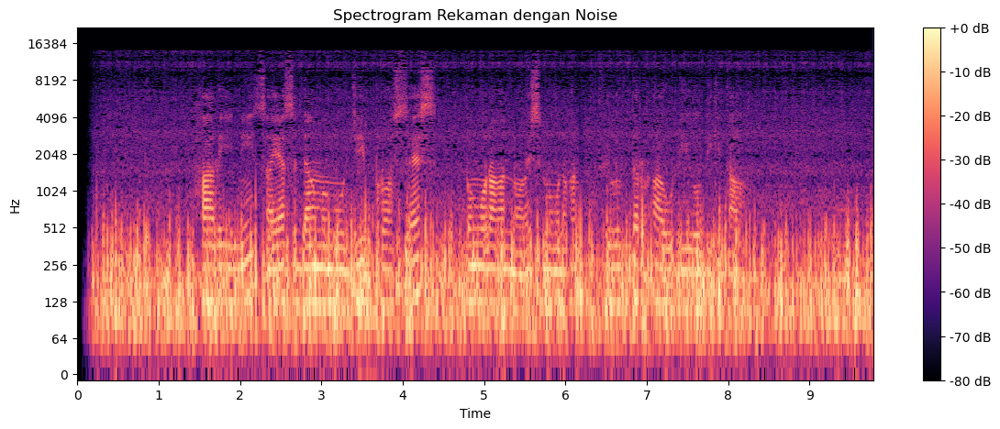

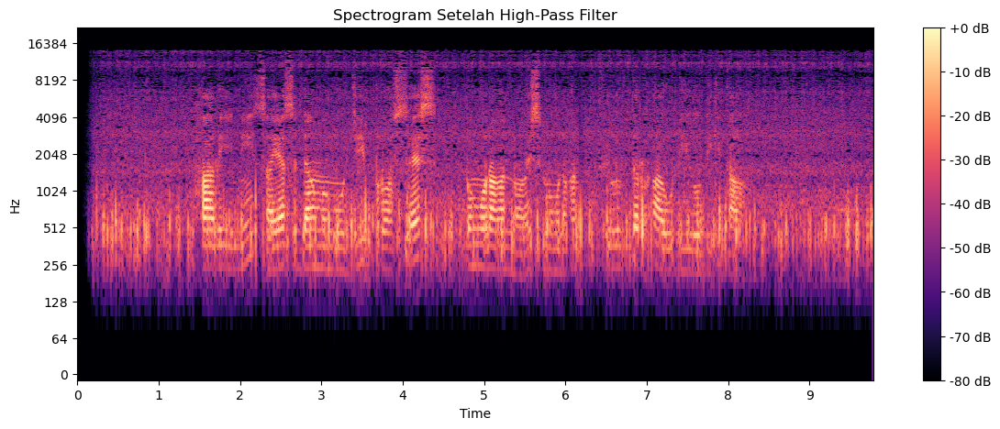

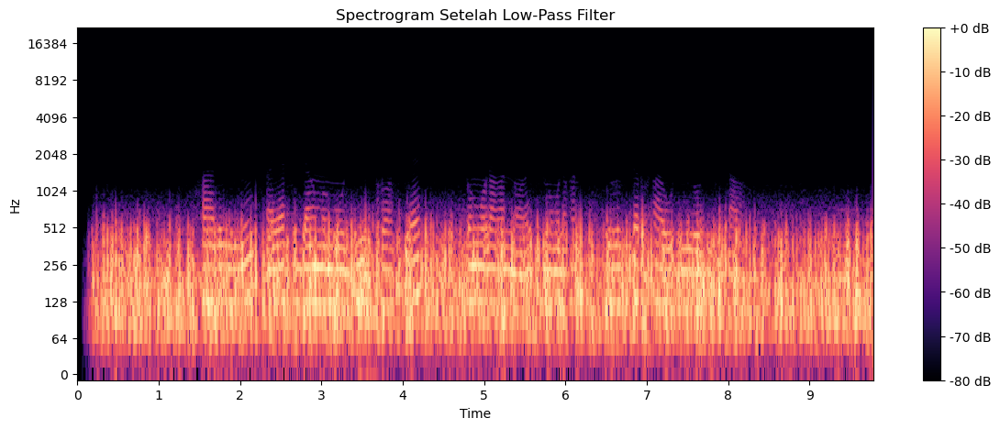

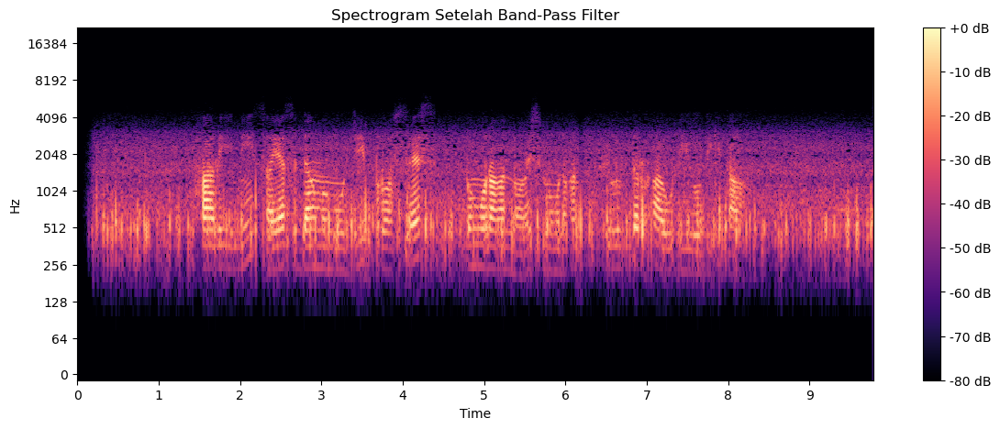

Audio Asli


Audio Setelah High-Pass Filter


Audio Setelah Low-Pass Filter


Audio Setelah Band-Pass Filter


In [36]:
# Fungsi Filter (High-Pass Filter, Low-Pass Filter, Band-Pass Filter)

def high_pass_filter(data, cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    y = lfilter(b, a, data)
    return y

def low_pass_filter(data, cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    y = lfilter(b, a, data)
    return y

def band_pass_filter(data, lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    y = lfilter(b, a, data)
    return y

# Fungsi Buat Visualisasi Spektrogram
def plot_spectrogram(y, sr, title):
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(title)
    plt.show()

# Load Audio File
audio_path_noise = 'Data/rekaman_noise.wav'
y_noise, sr_noise = librosa.load(audio_path_noise, sr=None)

# Audio Information
print(f'Sampling Rate: {sr_noise} Hz')
print(f'Audio Duration: {librosa.get_duration(y=y_noise, sr=sr_noise)} seconds')

# Spectogram Asli
plot_spectrogram(y_noise, sr_noise, 'Spectrogram Rekaman dengan Noise')

# Menerapkan Filter
cutoff_freq = 500

# High-Pass Filter
y_high_passed = high_pass_filter(y_noise, cutoff_freq, sr_noise)
plot_spectrogram(y_high_passed, sr_noise, 'Spectrogram Setelah High-Pass Filter')
sf.write('Data/rekaman_high_passed.wav', y_high_passed, sr_noise)

# Low-Pass Filter
y_low_passed = low_pass_filter(y_noise, cutoff_freq, sr_noise)
plot_spectrogram(y_low_passed, sr_noise, 'Spectrogram Setelah Low-Pass Filter')
sf.write('Data/rekaman_low_passed.wav', y_low_passed, sr_noise)

# Band-Pass Filter
lowcut = 500
highcut = 2500
y_band_passed = band_pass_filter(y_noise, lowcut, highcut, sr_noise)
plot_spectrogram(y_band_passed, sr_noise, 'Spectrogram Setelah Band-Pass Filter')
sf.write('Data/rekaman_band_passed.wav', y_band_passed, sr_noise)

# Play Audio
print('Audio Asli')
display(ipd.Audio(y_noise, rate=sr_noise))

print('Audio Setelah High-Pass Filter')
display(ipd.Audio(y_high_passed, rate=sr_noise))

print('Audio Setelah Low-Pass Filter')
display(ipd.Audio(y_low_passed, rate=sr_noise))

print('Audio Setelah Band-Pass Filter')
display(ipd.Audio(y_band_passed, rate=sr_noise))

### Soal 3. Pitch Shifting dan Audio Manipulation

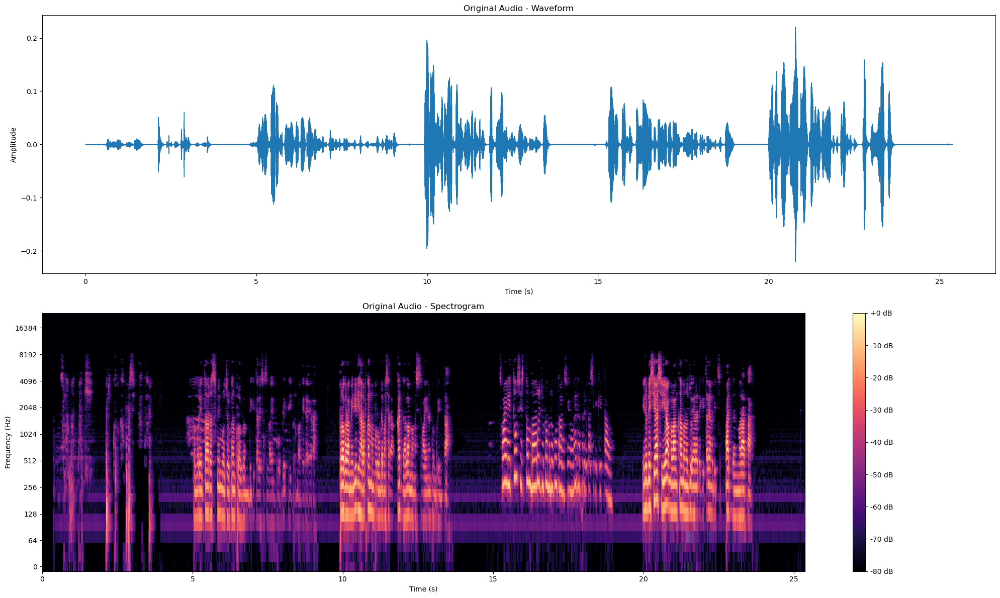

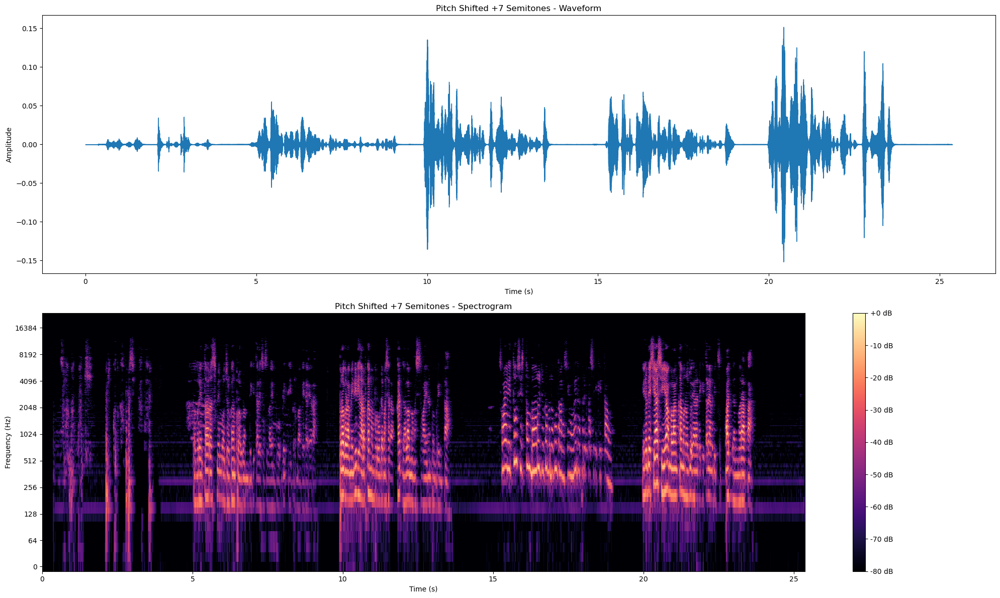

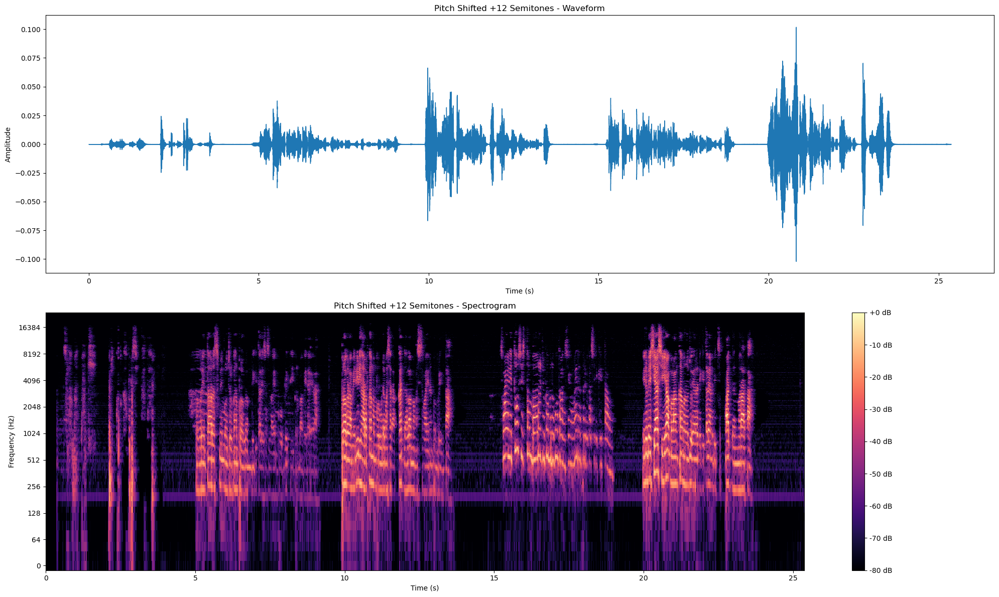

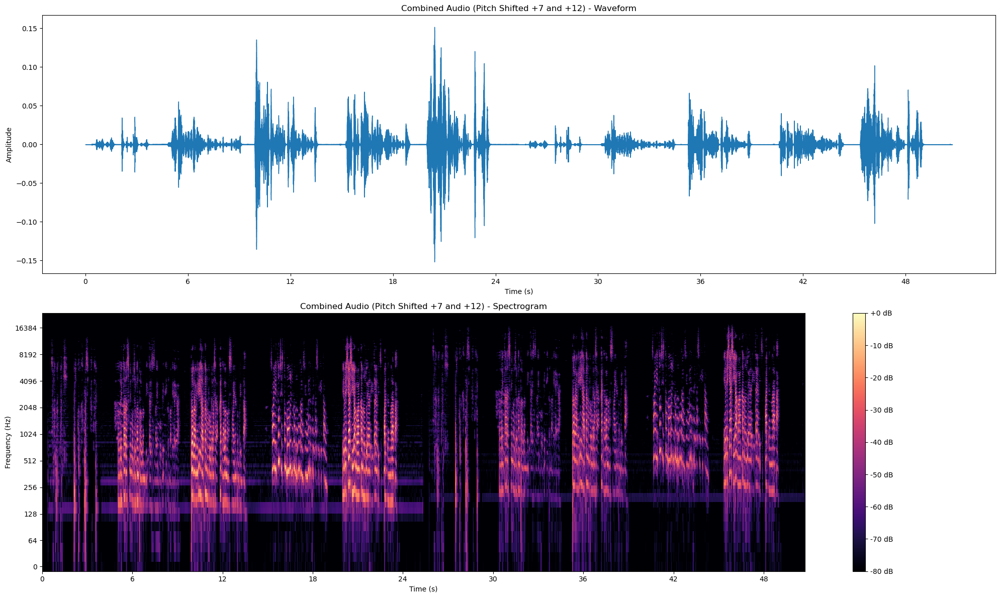

Audio Before Pitch Shifting


Audio After Pitch Shifting +7 Semitones


Audio After Pitch Shifting +12 Semitones


Combined Audio (Pitch Shifted +7 and +12)


In [41]:
# Fungsi untnuk visualisasi waveform dan spectrogram
def visualize_audio(y, sr, title="Audio Signal"):
    plt.figure(figsize=(20, 12))

    # Waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"{title} - Waveform")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

    # Spectrogram
    plt.subplot(2, 1, 2)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"{title} - Spectrogram")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    plt.tight_layout()
    plt.show()


# Load Audio File
audio_path = 'Data/rekaman_berita_multilevel.wav'
y, sr = librosa.load(audio_path, sr=None)

# Visualisasi Audio Asli
visualize_audio(y, sr, title="Original Audio")

# Pitch Shifting (+7 and +12 semitones)
y_pitch_7 = librosa.effects.pitch_shift(y=y, sr=sr, n_steps=7)
y_pitch_12 = librosa.effects.pitch_shift(y=y, sr=sr, n_steps=12)

# Visualisasi Audio Setelah Pitch Shifting
visualize_audio(y_pitch_7, sr, title="Pitch Shifted +7 Semitones")
visualize_audio(y_pitch_12, sr, title="Pitch Shifted +12 Semitones")

# Simpan Audio Setelah Pitch Shifting
sf.write('Data/rekaman_pitch_shifted_7.wav', y_pitch_7, sr)
sf.write('Data/rekaman_pitch_shifted_12.wav', y_pitch_12, sr)

# Gabungkan Audio Pitch Shifted +7 dan +12
y_combined = np.concatenate((y_pitch_7, y_pitch_12))
visualize_audio(y_combined, sr, title="Combined Audio (Pitch Shifted +7 and +12)")
sf.write('Data/rekaman_combined.wav', y_combined, sr)

# Play Audio Before Pitch Shifting and After Pitch Shifting
print('Audio Before Pitch Shifting')
display(ipd.Audio(y, rate=sr))
print('Audio After Pitch Shifting +7 Semitones')
display(ipd.Audio(y_pitch_7, rate=sr))
print('Audio After Pitch Shifting +12 Semitones')
display(ipd.Audio(y_pitch_12, rate=sr))
print('Combined Audio (Pitch Shifted +7 and +12)')
display(ipd.Audio(y_combined, rate=sr))


### Soal 4. Audio Processing Chain

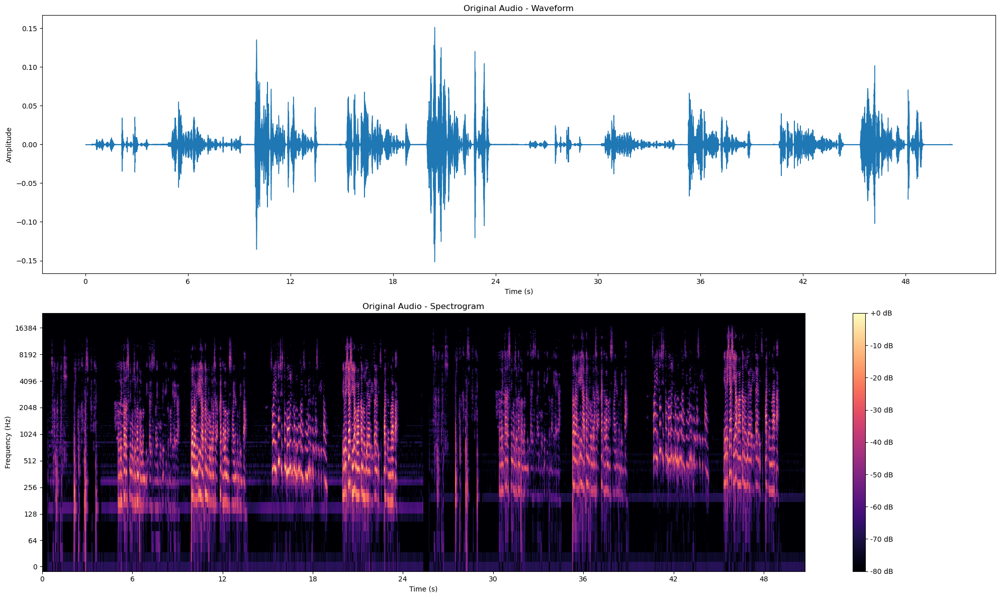

Silence trimming: Duration reduced from 50.73s to 46.82s
Equalization applied
Fade in and Fade out applied
Normalization applied: Loudness changed from -39.32 LUFS to -16.0 LUFS


c:\Users\arwid\miniconda3\envs\multimedia\lib\site-packages\pyloudnorm\normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


NameError: name 'y_final' is not defined

In [ ]:
import pyloudnorm as pyln

# Fungsi Processing Chain
# – Equalizer
# – Gain/fade
# – Normalization
# – Compression
# – Noise Gate
# – Silence trimming

def apply_trim(y, top_db=20):
    yt, index = librosa.effects.trim(y, top_db=top_db)
    print(f"Silence trimming: Duration reduced from {len(y)/sr:.2f}s to {len(yt)/sr:.2f}s")
    return yt

def apply_eq(data, sr, cutoff=8000, order=5):
    nyquist = 0.5 * sr
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    y = lfilter(b, a, data)
    print("Equalization applied")
    return y

def apply_noise_gate(y, sr, frame_length=2048, hop_length=512, threshold_db=-40):
    print("Applying Noise Gate...")
    threshold = librosa.db_to_amplitude(threshold_db)
    y_gated = np.copy(y)

    rms = librosa.feature.rms(y=y, frame_length=frame_length, hop_length=hop_length)[0]

    for i in range(len(rms)):
        if rms[i] < threshold:
            start = i * hop_length
            end = min(start + frame_length, len(y))
            y_gated[start:end] = 0

    return y_gated

def apply_fade(y, sr, fade_in_ms=100, fade_out_ms=200):
    fade_in_samples = int(sr * (fade_in_ms / 1000.0))
    fade_out_samples = int(sr * (fade_out_ms / 1000.0))
    
    fade_in = np.linspace(0, 1, fade_in_samples)
    fade_out = np.linspace(1, 0, fade_out_samples)
    
    y[:fade_in_samples] *= fade_in
    y[-fade_out_samples:] *= fade_out
    
    print("Fade in and Fade out applied")
    return y

def apply_normalization(y, sr, target_loudness=-16.0):
    meter = pyln.Meter(sr)
    loudness = meter.integrated_loudness(y)
    y_normalized = pyln.normalize.loudness(y, loudness, target_loudness)
    print(f"Normalization applied: Loudness changed from {loudness:.2f} LUFS to {target_loudness} LUFS")
    return y_normalized

# Fungsi Visualisasi Waveform and Spectrogram
def visualize_audio(y, sr, title="Audio Signal"):
    plt.figure(figsize=(20, 12))

    # Waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"{title} - Waveform")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

    # Spectrogram
    plt.subplot(2, 1, 2)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"{title} - Spectrogram")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    plt.tight_layout()
    plt.show()

# Load Audio File
audio_path = 'Data/rekaman_combined.wav'
y, sr = librosa.load(audio_path, sr=None)

# Visualisasi Audio Asli
visualize_audio(y, sr, title="Original Audio")

# Apply Processing Chain
y_trimmed = apply_trim(y)
y_eq = apply_eq(y_trimmed, sr)
y_faded = apply_fade(y_eq, sr)
y_normalized = apply_normalization(y_faded, sr)


# Visualisasi Audio Setelah Processing Chain
visualize_audio(y_final, sr, title="Processed Audio")

# Simpan Audio Setelah Processing Chain
sf.write('Data/rekaman_processed.wav', y_final, sr)

### Soal 5. Music Analysis dan Remix

File: Data/ardhito_pramono_i_just_couldn’t_save_you_tonight.wav, Tempo: 112.35 BPM, Key: C
File: Data/bruno_mars_locked_out_of_heaven.wav, Tempo: 143.55 BPM, Key: A
'I Just Couldn't Save You Tonight' stretched by a factor of 1.28 to match tempo of 'Locked Out of Heaven'
'I Just Couldn't Save You Tonight' pitch shifted by 9 semitones to match key of 'Locked Out of Heaven'
Menggabungkan kedua lagu dengan crossfade 8.00 detik
Visualisasi Audio Setelah Remix


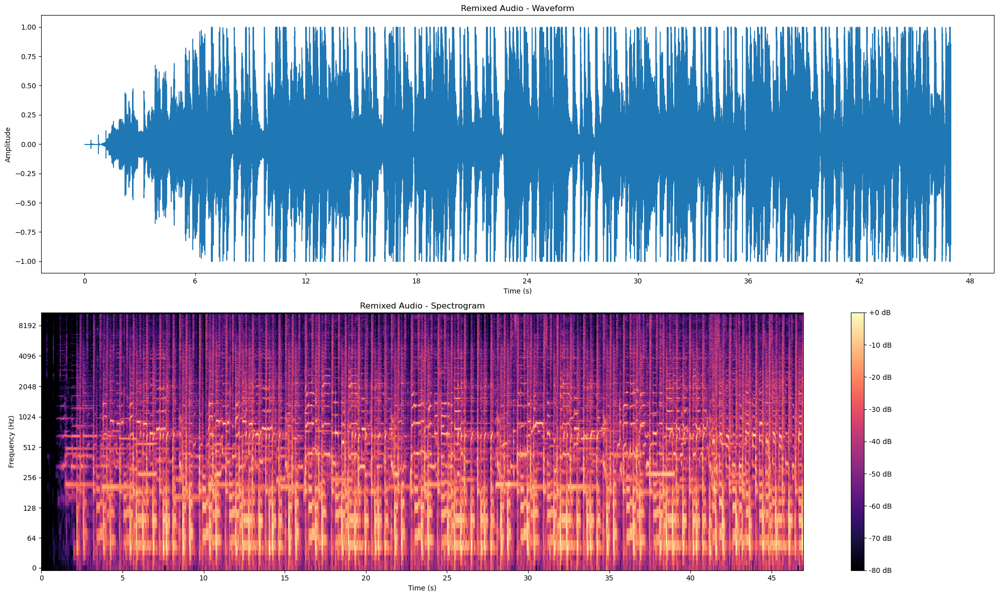

In [ ]:
from pydub import AudioSegment

# Fungsi Analasis Audio
def analyze_audio(audio_path):
    y, sr = librosa.load(audio_path)
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)
    chromagram = librosa.feature.chroma_stft(y=y, sr=sr)
    key_val = np.argmax(np.mean(chromagram, axis=1))
    notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    key = notes[key_val]
    return tempo, key, y, sr

# Fungsi Visualisasi Audio Waveform dan Spectrogram
def visualize_audio(y, sr, title="Audio Signal"):
    plt.figure(figsize=(20, 12))

    # Waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"{title} - Waveform")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

    # Spectrogram
    plt.subplot(2, 1, 2)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"{title} - Spectrogram")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")

    plt.tight_layout()
    plt.show()

# Load Audio File
file_lagu_sedih = 'Data/ardhito_pramono_i_just_couldn’t_save_you_tonight.wav'
file_lagu_ceria = 'Data/bruno_mars_locked_out_of_heaven.wav'

# Analisis Audio Deteksi Tempo
tempo1, key1, y1, sr1 = analyze_audio(file_lagu_sedih)
tempo2, key2, y2, sr2 = analyze_audio(file_lagu_ceria)

print(f"File: {file_lagu_sedih}, Tempo: {tempo1[0]:.2f} BPM, Key: {key1}")
print(f"File: {file_lagu_ceria}, Tempo: {tempo2[0]:.2f} BPM, Key: {key2}")

# Remix Audio Berdasarkan Tempo
stretch_rate = tempo2[0]/tempo1[0]
y1_stretched = librosa.effects.time_stretch(y1, rate=stretch_rate)
print(f"'I Just Couldn't Save You Tonight' stretched by a factor of {stretch_rate:.2f} to match tempo of 'Locked Out of Heaven'")

notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
semitone_to_shift = (notes.index(key2) - notes.index(key1)) % 12
y1_shifted = librosa.effects.pitch_shift(y=y1_stretched, sr=sr1, n_steps=semitone_to_shift)
print(f"'I Just Couldn't Save You Tonight' pitch shifted by {semitone_to_shift} semitones to match key of 'Locked Out of Heaven'")

# CrossFading
min_len = min(len(y1_shifted), len(y2))
sf.write('temp_song1.wav', y1_shifted[:min_len], sr1)
sf.write('temp_song2.wav', y2[:min_len], sr2)

sound1 = AudioSegment.from_wav('temp_song1.wav')
sound2 = AudioSegment.from_wav('temp_song2.wav')
crossfade_duration = 8000

remix = sound1.fade_out(crossfade_duration).overlay(sound2.fade_in(crossfade_duration))
remix.export('Data/remix_song.wav', format='wav')
print(f"Menggabungkan kedua lagu dengan crossfade {crossfade_duration/1000:.2f} detik")

# Visualisasi Audio Setelah Remix
print("Visualisasi Audio Setelah Remix")
y_remix, sr_remix = librosa.load('Data/remix_song.wav', sr=None)
visualize_audio(y_remix, sr_remix, title="Remixed Audio")

# Play the Audio

